<a href="https://colab.research.google.com/github/Andrew-Helmer/pmj-cpp/blob/master/analyses/PMJ_Visualizations.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
#@title
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib as mpl
import numpy as np
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

from cycler import cycler
default_cycler = (cycler(color=['steelblue', 'darkred', 'darkgreen', 'magenta', 'tomato', 'cornflowerblue', 'gold']))
plt.rc('axes', prop_cycle=default_cycler)

In [0]:
import urllib
def read_file_from_url(url):
  request = urllib.request.Request(url)
  file = urllib.request.urlopen(request)
  return file.read().decode("utf-8")

# Animations and Visualizations of the Sampling

In [0]:
#@title
# This function will generate the animation.
def get_pts_animation(data, title, animate_grid_division=True):
  fig = plt.figure(figsize=(8, 8))
  ax = plt.axes(xlim=(0, 1.0), ylim=(0, 1.0))
  scatter = ax.scatter([], [], s=10, edgecolors='black')

  ax.grid(True, which='major')
  ax.grid(True, which='minor', linestyle='dotted')
  plt.title(title, size=20, color='k', pad=20)

  def animate(i, data, scatter, ax):
    colors = ['steelblue']*(i-1) + ['lime']
    edgecolors = ['steelblue']*(i-1) + ['k']
    sizes = [10]*(i-1) + [50]
    scatter.set_offsets(data[:i])
    scatter.set_color(colors)
    scatter.set_edgecolors(edgecolors)
    scatter.set_sizes(sizes)
    
    dim = 2
    if animate_grid_division:
      while (dim*dim < i): dim *= 2
    else:
      dim = 4
    major_ticks = [0.0] + [(x+1)/(dim//2) for x in range(dim//2)] + [1.0]
    minor_ticks = [(x+1)/dim for x in range(dim)]
    ax.set_yticks(major_ticks)
    ax.set_yticks(minor_ticks, minor=True)
    ax.set_xticks(major_ticks)
    ax.set_xticks(minor_ticks, minor=True)
    if i >= 1:
      cur_pt = data[i-1]
      ax.set_xlabel("({:.3f}, {:.3f})".format(cur_pt[0], cur_pt[1]), labelpad=10, color='gray')

    return scatter,

  anim = FuncAnimation(fig, animate,
                       frames=len(data), fargs=(data, scatter, ax), interval=100)

  plt.tight_layout(pad=0)
  plt.close()
  return anim

In [213]:
url = 'https://raw.githubusercontent.com/Andrew-Helmer/pmj-cpp/master/sample_sequences/pmjbn/1024_samples_00.txt'
file = read_file_from_url(url)
data = "[" + file.replace('\n', ' ') + "]"
pmjbn_pts = np.array(eval(data)[:256])

pmjbn_anim = get_pts_animation(pmjbn_pts, "Progressive Multi-Jittered Sampling w/ Blue Noise")
HTML(pmjbn_anim.to_jshtml())

In [0]:
# Uncomment to save the animation.
pmjbn_anim.save('pmjbn.gif', writer="pillow", fps=10)  

# Note that this generates huge file sizes. Worth optimizing afterwards.
# https://ezgif.com/optimize with the "Optimize Transparency" options works
# well.

In [0]:
# Load PMJ(0,2) pts w/ blue noise.
url = 'https://raw.githubusercontent.com/Andrew-Helmer/pmj-cpp/master/sample_sequences/pmj02bn/1024_samples_00.txt'
file = read_file_from_url(url)
data = "[" + file.replace('\n', ' ') + "]"
pmj02bn_pts = np.array(eval(data)[:256])

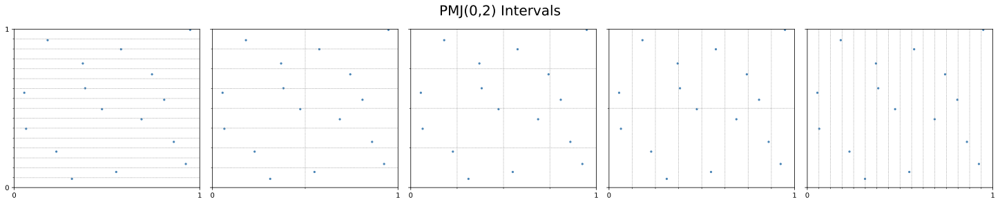

In [216]:
#@title Plot (0,2) intervals for 16 point sub-sequences.
import math

def create_pmj02_plot(data, max_strata=1):
  while (max_strata < len(data)):
    max_strata *= 2

  x_strata = 1
  y_strata = max_strata
  octaves = [(x_strata, y_strata)]
  while (x_strata < max_strata):
    x_strata *= 2
    y_strata //= 2
    octaves.append((x_strata, y_strata))
  # octaves.reverse()

  x, y = zip(*data)
  
  n_cols = len(octaves)
  n_rows = 1
  fig = plt.figure(constrained_layout=True, figsize=(n_cols*4, n_rows*4))
  grid_spec = gridspec.GridSpec(ncols=n_cols, nrows=n_rows, figure=fig)

  fig.suptitle('PMJ(0,2) Intervals', size=20, color='k')

  axs = []
  for i in range(len(octaves)):
    idx = i
    axs.append(fig.add_subplot(grid_spec[(idx//n_cols), (idx%n_cols)]))
    if (idx%n_cols) > 0:
      plt.setp(axs[i].get_yticklabels(), visible=False)

  for (ax, strata) in zip(axs, octaves):
    scatter = ax.scatter(x, y, s=5, color='steelblue')
    ax.set_xlim(0.0, 1.0)
    ax.set_ylim(0.0, 1.0)

    x_ticks = []
    y_ticks = []
    x_strata = strata[0]
    y_strata = strata[1]

    x_ticks = [float(x_stratum)/x_strata for x_stratum in range(1, x_strata)]
    y_ticks = [float(y_stratum)/y_strata for y_stratum in range(1, y_strata)]
    ax.set_xticks(x_ticks, minor=True)
    ax.set_yticks(y_ticks, minor=True)
    ax.grid(True, which='minor', linestyle='dotted', c='gray')

    ax.set_xticks([0.0, 1.0])
    ax.set_yticks([0.0, 1.0])

create_pmj02_plot(pmj02bn_pts[:16])

In [217]:
data = np.array(pmj02bn_pts)
pmj02bn_anim = get_pts_animation(data, "Progressive Multi-Jittered Sampling (0,2) w/ Blue Noise", animate_grid_division=True)
HTML(pmj02bn_anim.to_jshtml())

In [0]:
# Uncomment to save the animation
pmj02bn_anim.save('pmj02bn.gif', writer="pillow", fps=10) 

# Note that this generates huge file sizes. Worth optimizing afterwards.
# https://ezgif.com/optimize with the "Optimize Transparency" options works
# well.